In [1]:
from ultralytics import YOLO


In [2]:
model = YOLO('yolov8_calories.pt')

In [52]:
r = model("images/2024-05-28-20-13-00-736.jpg")[0]
r.

Invalid SOS parameters for sequential JPEG


image 1/1 /home/jaeho/capstone/server/images/2024-05-28-20-13-00-736.jpg: 640x480 3 접시s, 190.4ms
Speed: 3.7ms preprocess, 190.4ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 480)


In [24]:
results = model("../data/validation/분류/images/2405150001.jpg")
yolo_result = results[0]

labels = yolo_result.names
for box in yolo_result.boxes:
    if box.cls == 0:
        continue
    print()
#     cls = box.cls.cpu()
#     food_name = labels[int(cls)]

#     kcal = food_df.loc[food_name]["에너지(kcal)"]
#     carbohydrate = food_df.loc[food_name]["탄수화물(g)"]
#     fat = food_df.loc[food_name]["지방(g)"]
#     protein = food_df.loc[food_name]["단백질(g)"]
#     sugar = food_df.loc[food_name]["당류(g)"]

#     return food_name, kcal * quantity, carbohydrate * quantity, protein * quantity, fat * quantity, sugar * quantity
# return 0,0,0,0,0



image 1/1 /home/jaeho/capstone/server/../data/validation/분류/images/2405150001.jpg: 640x320 1 접시, 1 짜장라면, 172.0ms
Speed: 2.4ms preprocess, 172.0ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 320)
[     35.559      1187.1      1515.1      2701.9]


In [48]:
from model_tools import overlay_images, create_text_image
from PIL import Image

# bbox (x0, y0, x1, y1) 설정
bbox = (1000,1000,2000,2000)
# 사용할 폰트 경로
font_path = "gulim.ttc"
# 텍스트 리스트
text_list = ["떡만둣국", "3000kcal"]
# 큰 폰트 사이즈와 작은 폰트 사이즈 설정
large_font_size = 250
small_font_size = 200
background_image_path = '2024-05-28-20-13-00-736.jpg'


print('overlay_images')
# 배경 이미지 열기
background = Image.open('images/'+background_image_path).convert('RGBA').rotate(180)

# bbox 크기 계산
bbox_width = bbox[2] - bbox[0]
bbox_height = bbox[3] - bbox[1]

# 텍스트 이미지 생성
text_image = create_text_image(int(bbox_width*0.5),int( bbox_height*0.3), font_path, text_list, large_font_size, small_font_size)

# 텍스트 이미지의 위치 계산 (bbox의 가운데)
text_width, text_height = text_image.size
position = (bbox[0] + (bbox_width - text_width) // 2, bbox[1] + (bbox_height - text_height) // 2)

# 텍스트 이미지 합성
combined = Image.alpha_composite(background, Image.new('RGBA', background.size))
combined.paste(text_image, position, text_image)
combined = combined.convert('RGB')

# # 결과 저장
# combined.save(f'images/{background_image_path}')  # 결과 이미지를 파일로 저장
# print(f"image saved at images/{background_image_path}")

overlay_images


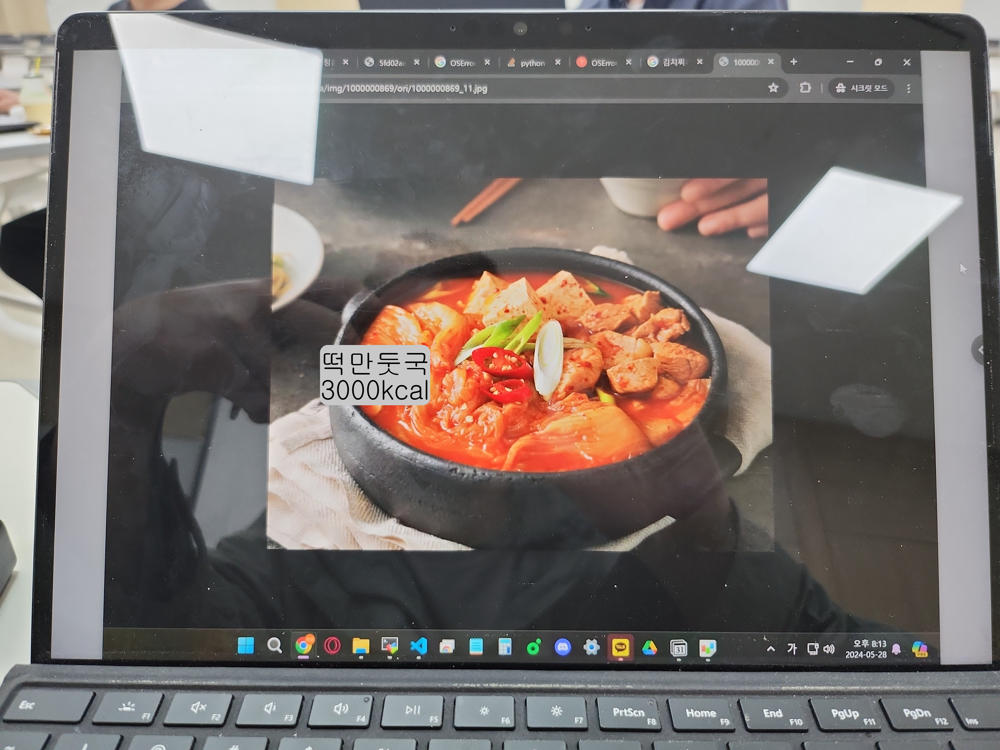

In [49]:
combined

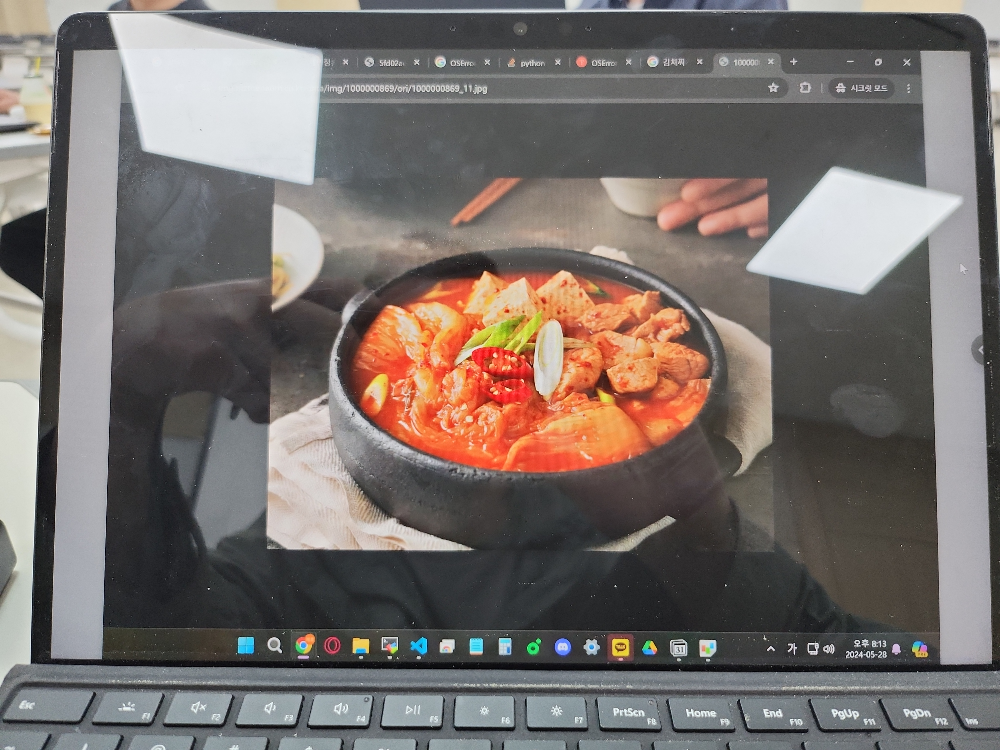

In [47]:
Image.open('images/'+background_image_path).convert('RGBA').rotate(180)
